In [18]:
import numpy as np
import rasterio
from rasterio.features import shapes
import shapely
from shapely.geometry import Polygon, mapping, shape, MultiPolygon
import fiona
from fiona.crs import from_epsg
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from rasterio.plot import show, show_hist
import pandas as pd
import geopandas as gpd
import os
import glob
import warnings
import pickle

In [19]:
#funciones

#funcion que partir de una lista de boolean arrays me devuelve un dataframe
# con los poligonos
# input: lista de boolean arrays

def bool_to_pol(boolean_arrays):
    multipolygon_list = []

    for boolean_array in boolean_arrays:
        shapes = rasterio.features.shapes(boolean_array.astype(np.uint8), mask=boolean_array, transform=rasterio.Affine(1, 0, 0, 0, 1, 0))
        polygons = [shape(geom) for geom, value in shapes if value == 1]
        multipolygon = MultiPolygon(polygons)
        multipolygon_list.append(multipolygon)

# Crear un DataFrame a partir de la lista de multipolígonos
    return pd.DataFrame({"Multipolygon": multipolygon_list}) 

###################################################################
# funcion que a partir de un data frame de poligonos genera un geodataframe
# inputs: pd, gt, crs

def pd_to_gpd(df,gt,crs):
# Crea una lista para almacenar los polígonos georeferenciados
    georeferenced_polygons = []

# Itera sobre los polígonos en el DataFrame
    for polygon in df['Multipolygon']:
        if isinstance(polygon, Polygon):
        # Apply the geotransformation to each point of the polygon
            transformed_coords = [gt * (x, y) for x, y in polygon.exterior.coords]
        # Create a new georeferenced polygon from the transformed coordinates
            georeferenced_polygon = Polygon(transformed_coords)
            georeferenced_polygons.append(georeferenced_polygon)
        elif isinstance(polygon, MultiPolygon):
        # Handle MultiPolygon objects
            georeferenced_subpolygons = []
            for subpolygon in polygon.geoms:
                transformed_coords = [gt * (x, y) for x, y in subpolygon.exterior.coords]
                georeferenced_subpolygon = Polygon(transformed_coords)
                georeferenced_subpolygons.append(georeferenced_subpolygon)
            georeferenced_polygon = MultiPolygon(georeferenced_subpolygons)
            georeferenced_polygons.append(georeferenced_polygon)

# elimina la columna Multipolygon
    df = df.drop('Multipolygon', axis=1)
# Crea un GeoDataFrame a partir de los polígonos georeferenciados
    return gpd.GeoDataFrame(df, geometry=georeferenced_polygons, crs=crs)

In [20]:
#carpeta de datos
datapath= "./results/"

In [21]:

# Obtener la lista de nombres de archivos que coinciden con el patrón
masks_meta_files = glob.glob('./output_meta/*')
#crear la lista de dataframe
df_list= []
for files in masks_meta_files:
    boolean_arrays = np.load(files)
    df= bool_to_pol(boolean_arrays)
    df_list.append(df)

In [22]:
print(df_list[0]['Multipolygon'][2])

MULTIPOLYGON (((401 122, 432 122, 432 123, 463 123, 463 124, 467 124, 467 125, 468 125, 468 126, 469 126, 469 127, 471 127, 471 128, 472 128, 472 129, 473 129, 473 130, 474 130, 474 132, 475 132, 475 137, 476 137, 476 149, 477 149, 477 153, 476 153, 476 160, 477 160, 477 162, 476 162, 476 174, 477 174, 477 186, 478 186, 478 194, 479 194, 479 202, 478 202, 478 203, 477 203, 477 204, 474 204, 474 205, 466 205, 466 206, 455 206, 455 207, 438 207, 438 208, 429 208, 429 209, 410 209, 410 210, 401 210, 401 211, 397 211, 397 210, 395 210, 395 209, 394 209, 394 190, 395 190, 395 166, 396 166, 396 152, 397 152, 397 141, 398 141, 398 134, 399 134, 399 125, 400 125, 400 123, 401 123, 401 122), (470 164, 470 167, 471 167, 471 164, 470 164)))


In [23]:
# elimina el nombre base del file para armarme el diccionario
names_list=[]
for ruta in masks_meta_files:
# Obtener el nombre base del archivo sin la extensión
    nombre_base = os.path.splitext(os.path.basename(ruta))[0]
# Quedarse con la parte deseada del nombre base
    names = nombre_base.split("_", maxsplit=2)[2]
    names_list.append(names)


In [24]:
print(names_list)

['B2124_rec_0_2', 'B2124_rec_3_4', 'B2124_rec_3_5', 'B2124_rec_1_3', 'B2124_rec_1_4', 'B2124_rec_4_5', 'B2124_rec_4_4', 'B2124_rec_1_2', 'B2124_rec_2_5', 'B2124_rec_4_2', 'B2124_rec_2_1', 'B2124_rec_3_2', 'B2124_rec_4_1', 'B2124_rec_2_4', 'B2124_rec_3_1', 'B2124_rec_1_1', 'B2124_rec_4_0', 'B2124_rec_4_3', 'B2124_rec_0_5', 'dog', 'B2124_rec_0_3', 'B2124_rec_0_4', 'B2124_rec_2_3', 'B2124_rec_0_1', 'B2124_rec_2_2', 'B2124_rec_1_0', 'B2124_rec_1_5', 'B2124_rec_2_0', 'B2124_rec_3_3', 'B2124_rec_3_0', 'B2124_rec_0_0']


In [25]:
# leer los .png de acuerdo al orden que fueron leidos las mascaras
# orto files esta ordenado igual que los nombres de las mascaras
ortho_files_png=[]
for i in range(len(names_list)):
    file = datapath+'input_images/'+names_list[i]+'.png'
    ortho_files_png.append(file)


In [26]:
print(ortho_files_png)

['./results/input_images/B2124_rec_0_2.png', './results/input_images/B2124_rec_3_4.png', './results/input_images/B2124_rec_3_5.png', './results/input_images/B2124_rec_1_3.png', './results/input_images/B2124_rec_1_4.png', './results/input_images/B2124_rec_4_5.png', './results/input_images/B2124_rec_4_4.png', './results/input_images/B2124_rec_1_2.png', './results/input_images/B2124_rec_2_5.png', './results/input_images/B2124_rec_4_2.png', './results/input_images/B2124_rec_2_1.png', './results/input_images/B2124_rec_3_2.png', './results/input_images/B2124_rec_4_1.png', './results/input_images/B2124_rec_2_4.png', './results/input_images/B2124_rec_3_1.png', './results/input_images/B2124_rec_1_1.png', './results/input_images/B2124_rec_4_0.png', './results/input_images/B2124_rec_4_3.png', './results/input_images/B2124_rec_0_5.png', './results/input_images/dog.png', './results/input_images/B2124_rec_0_3.png', './results/input_images/B2124_rec_0_4.png', './results/input_images/B2124_rec_2_3.png

In [27]:
#crear la lista de geotrasnformacion y el crs por cada tif (ortho files)
gt_list=[]
#crs_list=[]
for files in names_list:
    with rasterio.open("input_images/" + files + ".png" ) as src:
    # Leer la matriz de geotransformación
        geotransformacion = src.transform
        crs = src.crs
    gt_list.append(geotransformacion)
    #crs_list.append(crs)

In [28]:
# Guardar la lista en un archivo numpy

# Crear la carpeta en el directorio especificado
ruta_completa = os.path.join("./results/", 'gt/')
os.makedirs(ruta_completa, exist_ok=True)

for gt, nombre_archivo in zip(gt_list,names_list):
    np.save(ruta_completa+'gt_'+nombre_archivo+'.npy', gt)

In [29]:
# Guardar la lista en un archivo binario utilizando pickle

# Crear la carpeta en el directorio especificado
ruta_completa = os.path.join("./results/", 'gt/')
os.makedirs(ruta_completa, exist_ok=True)

for gt, nombre_archivo in zip(gt_list,names_list):
    with open(ruta_completa+'gt_'+nombre_archivo+'.pkl', 'wb') as archivo:
        pickle.dump(gt, archivo)

In [30]:
# ahora con el df_list y gt_list estan indexados de forma tal que cada elemento i-esimos
# corresponde al mismo tif. De esta forma se pueden combinar facilmente.
# El crs es el mismo para todos, lo que cambia es el pd y la gt
warnings.filterwarnings("ignore")
gdf_list = []
for i in range(len(names_list)): 
    gdf=pd_to_gpd(df_list[i],gt_list[i],crs)
    gdf['Area'] = gdf.area
    gdf_list.append(gdf) 

In [31]:
# Guardar los geopandas con el siguiente formato "gpd_+nombre del tif"
# Ruta completa de la carpeta que se creará
ruta_completa = os.path.join(datapath, 'gdf_meta/')

# Crear la carpeta en el directorio especificado
os.makedirs(ruta_completa, exist_ok=True)

for geopandas_obj, nombre_archivo in zip(gdf_list,names_list):
    # Guardar el GeoPandas en formato shapefile
    geopandas_obj.to_file(ruta_completa+"gdf_"+ nombre_archivo+ ".shp")
    

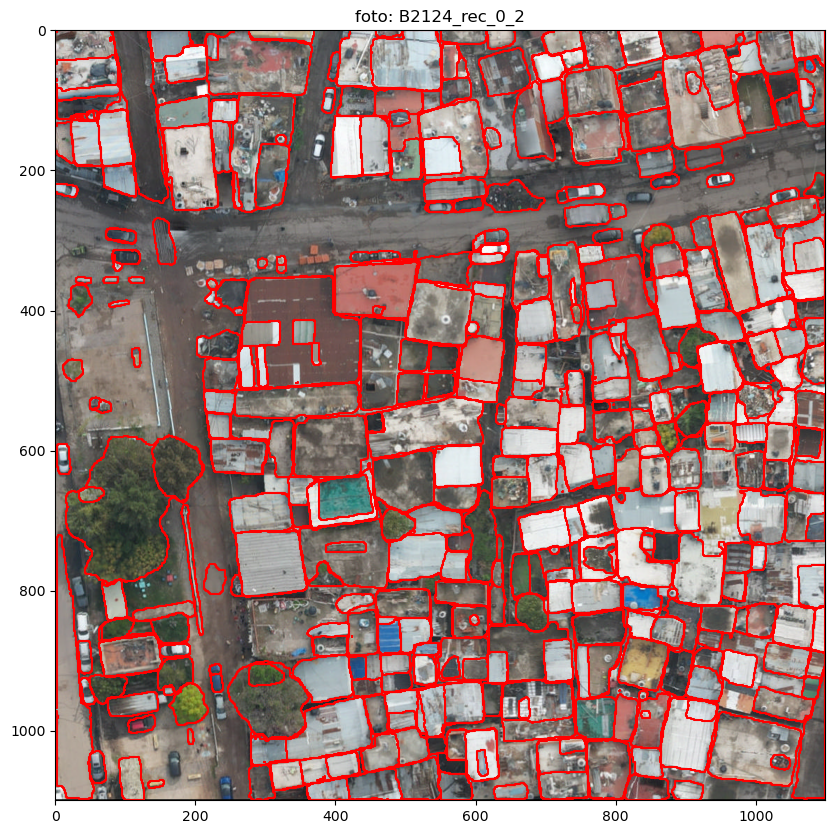

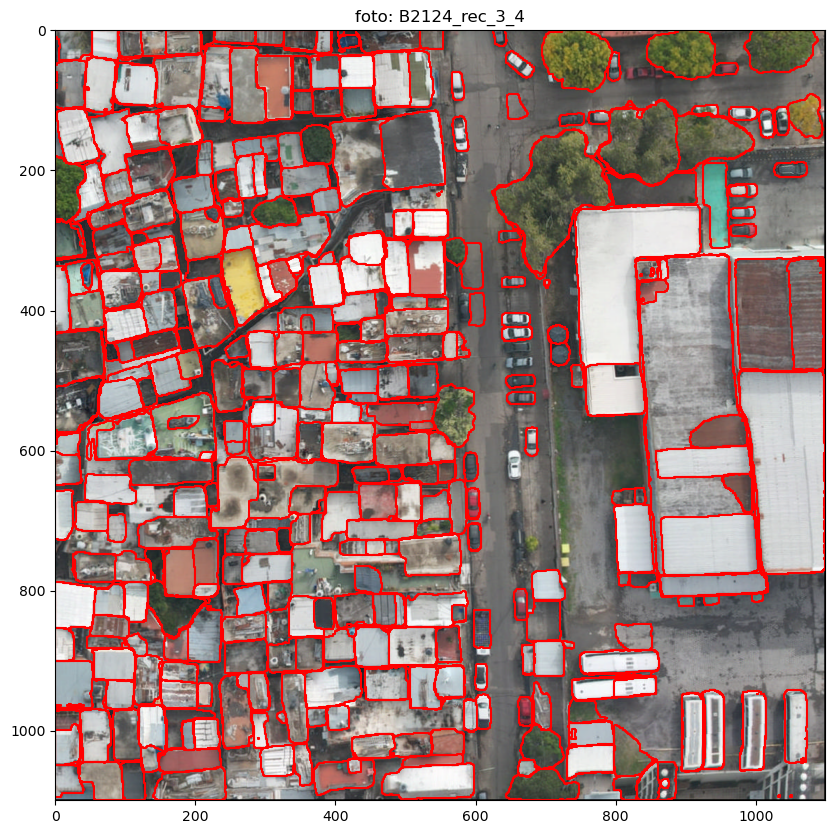

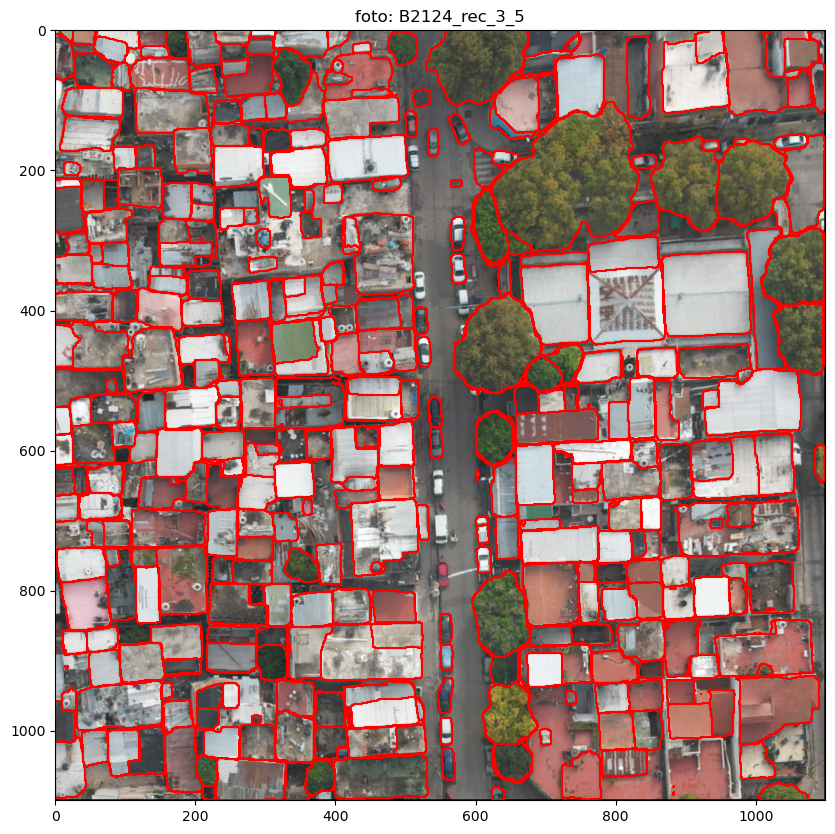

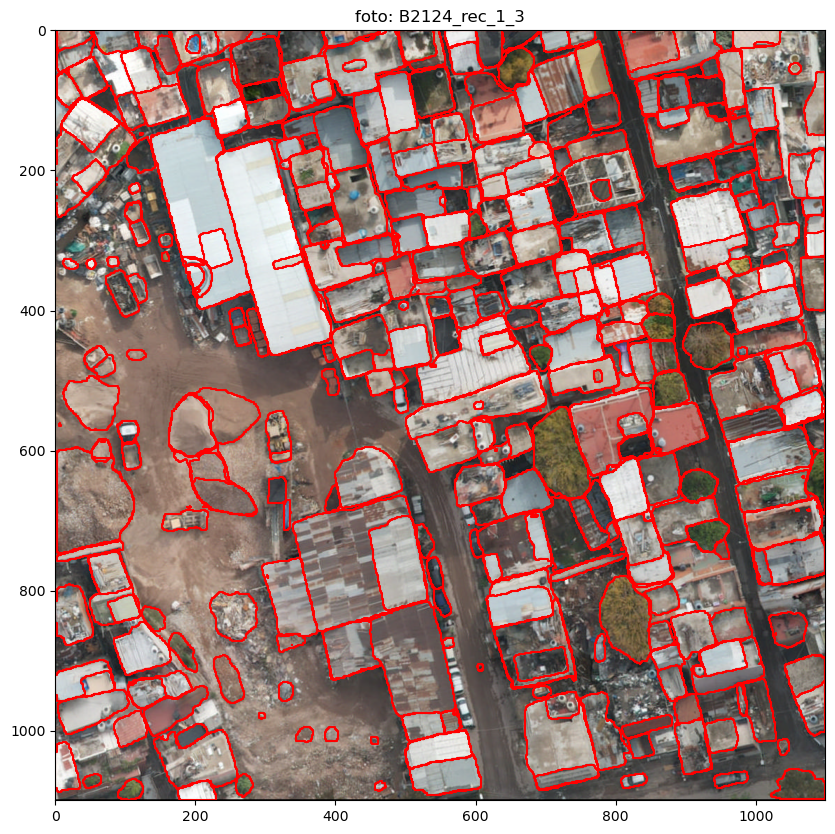

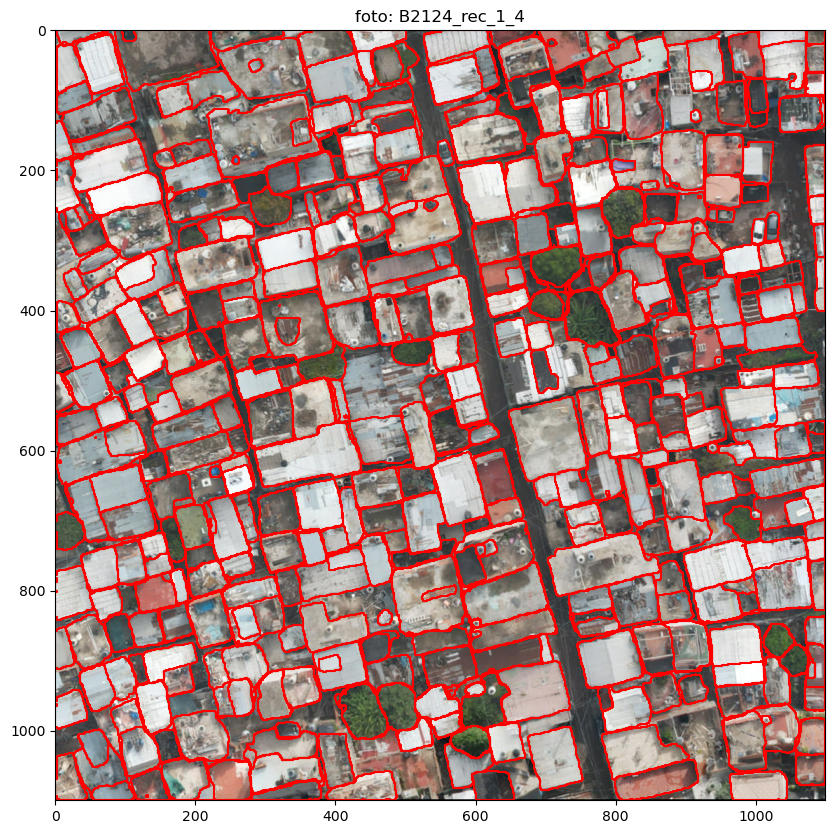

...

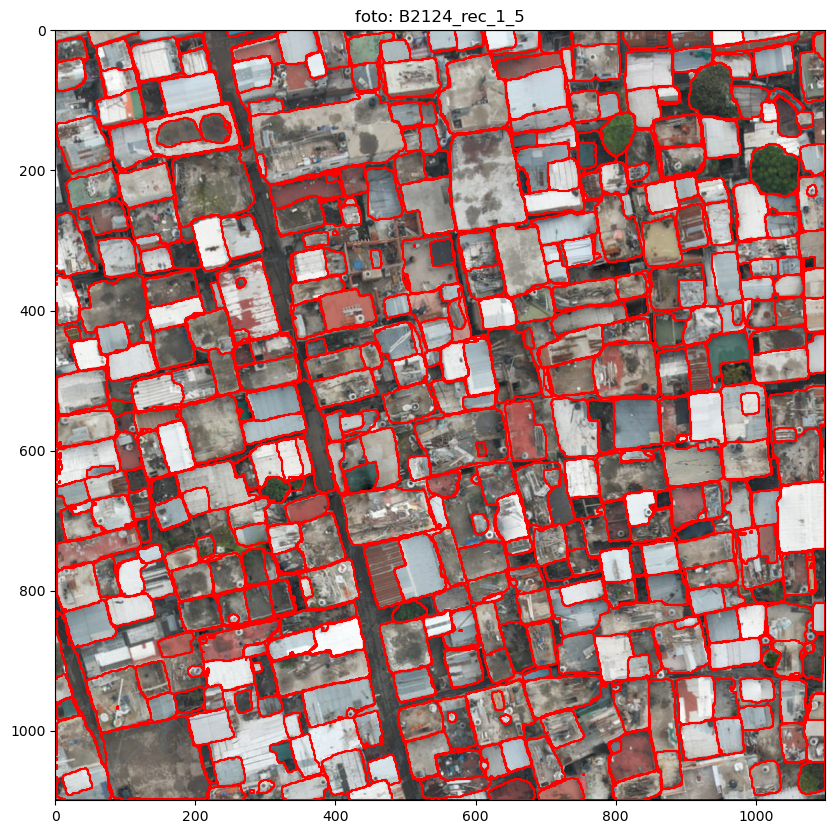

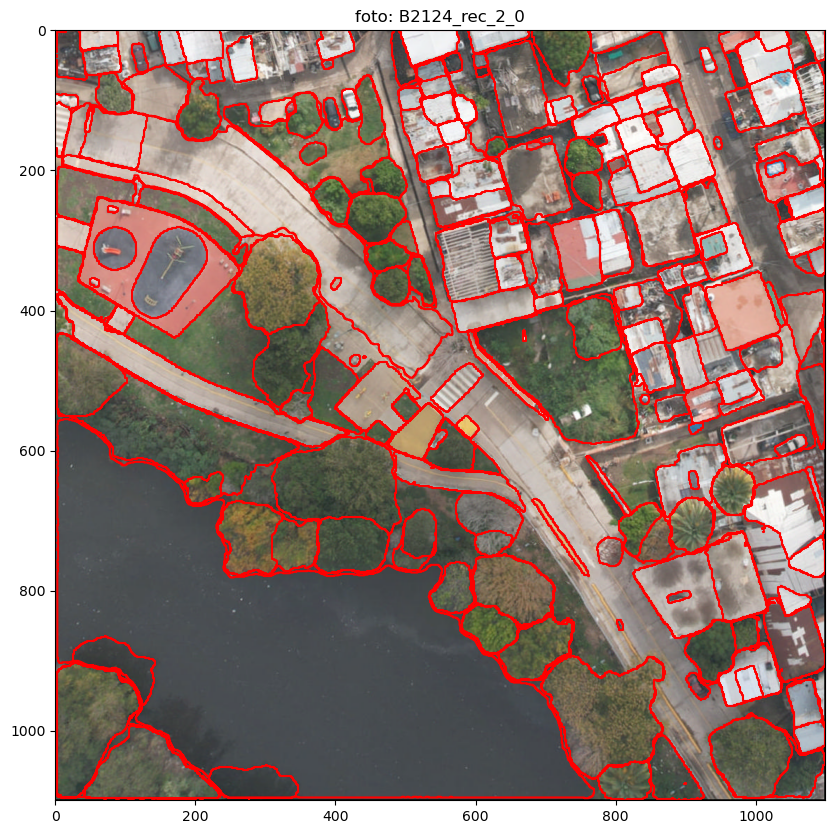

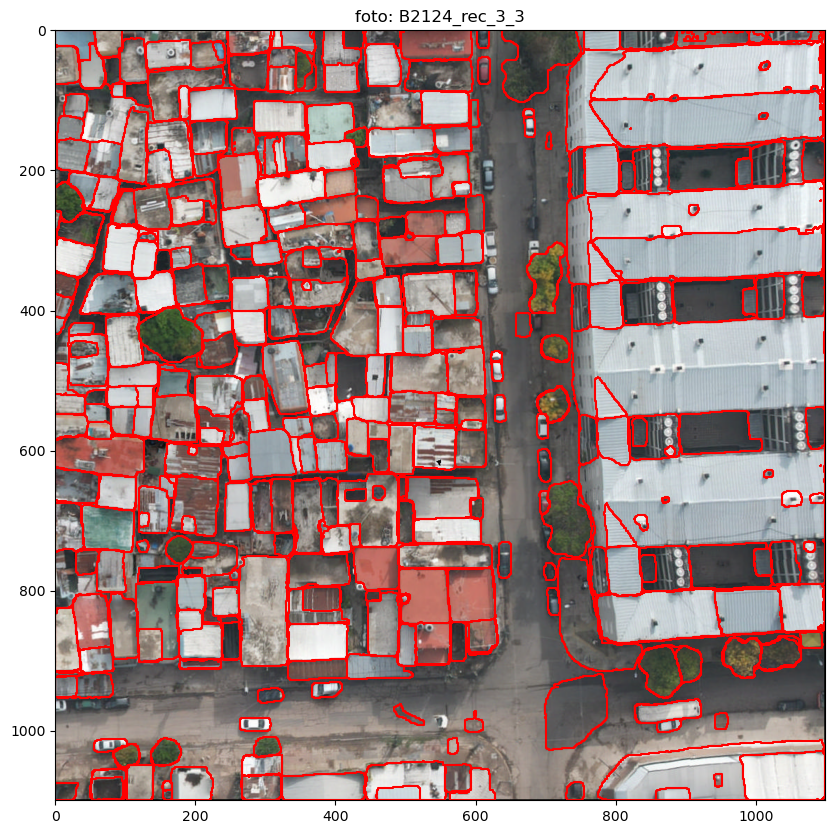

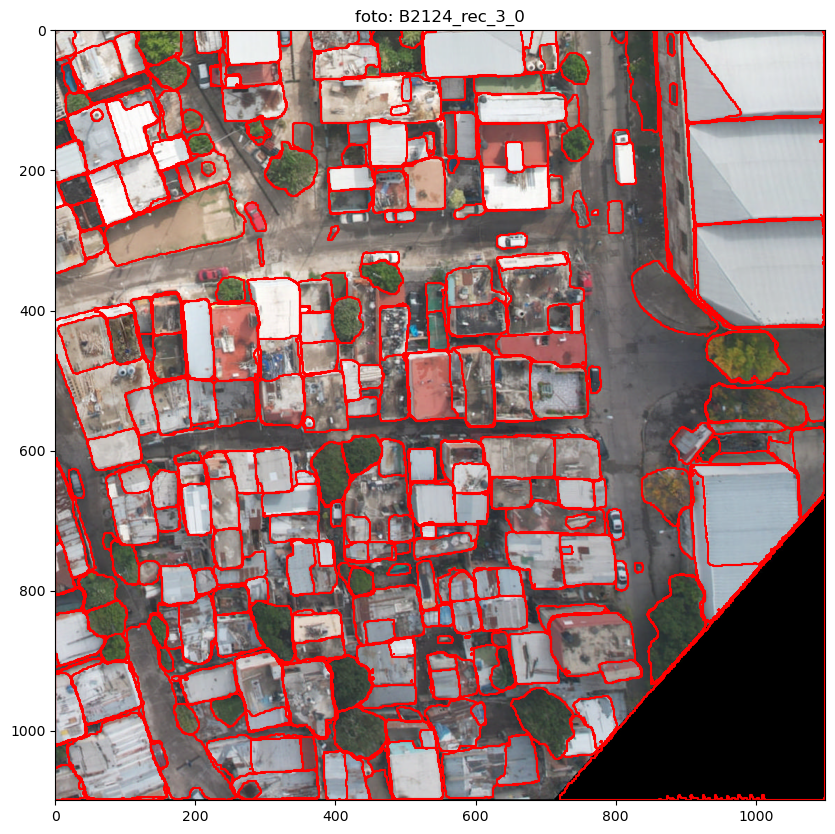

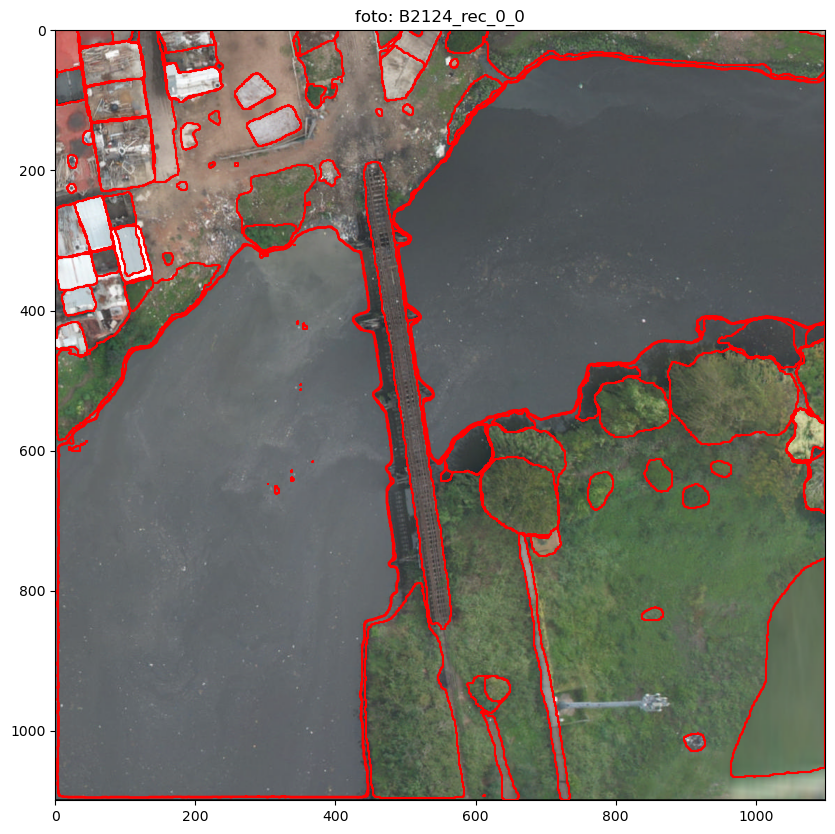

In [32]:
# Dibujar todos los .png con el poligono y guardar
ruta_completa = os.path.join(datapath, 'plot_meta/')
# Crear la carpeta en el directorio especificado
os.makedirs(ruta_completa, exist_ok=True)

for n in range(len(names_list)): 
    ortho = rasterio.open("input_images/"+ names_list[n]+".png")

    fig, ax = plt.subplots(figsize=(10, 10))
    ax.set_title('foto: '+names_list[n])

    # Muestra el GeoTIFF en el eje
    show(ortho, ax=ax)

    # Muestra el GeoDataFrame en el eje
    gdf_list[n].boundary.plot(ax=ax, color='red')

    # guardo el plot
    plt.savefig(ruta_completa+"plot_"+ names_list[n]+ ".png")

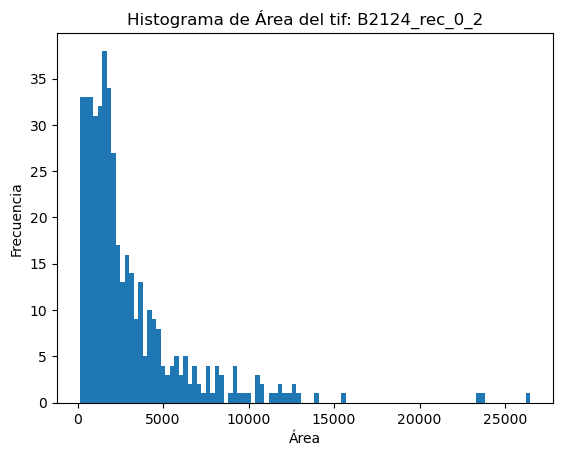

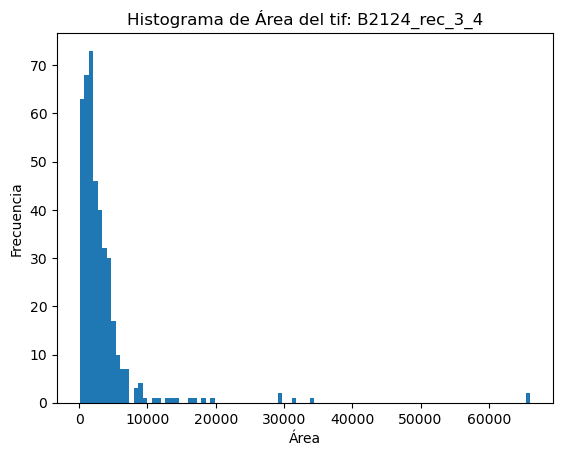

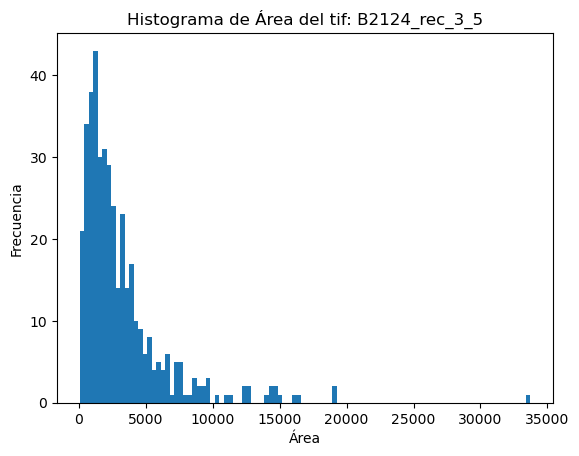

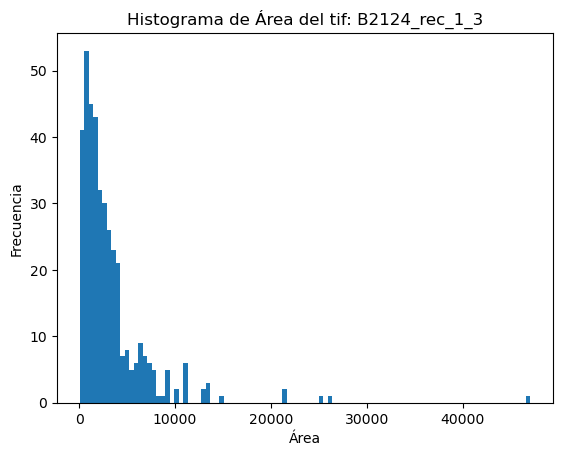

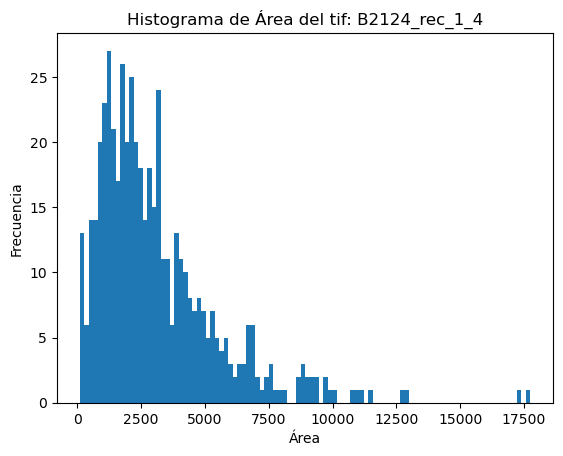

...

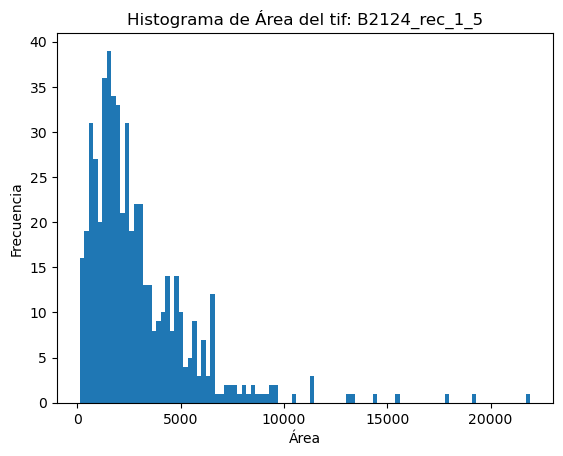

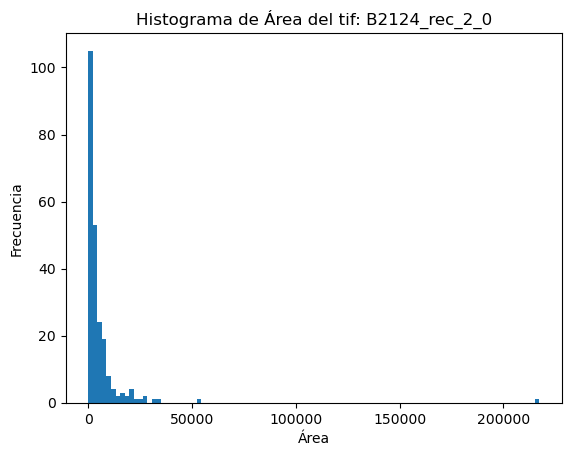

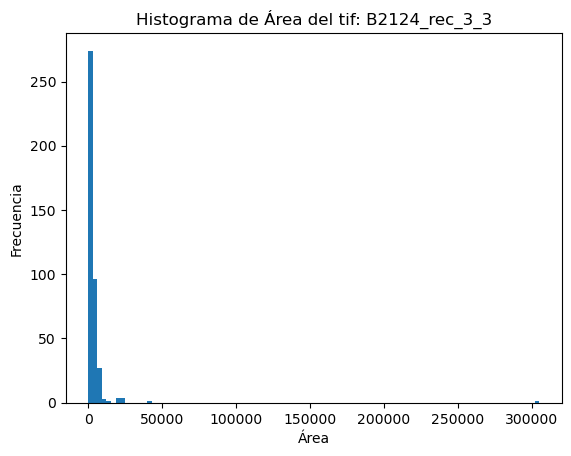

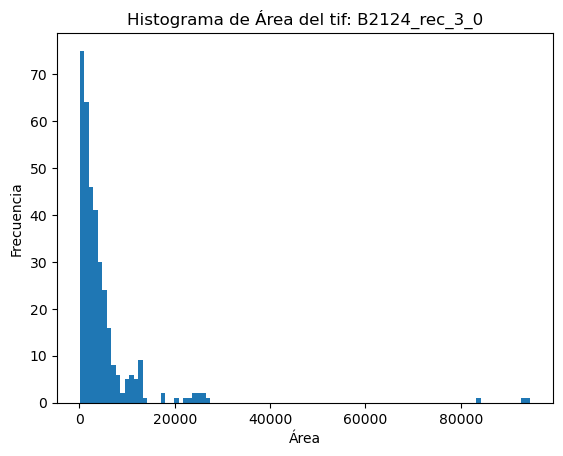

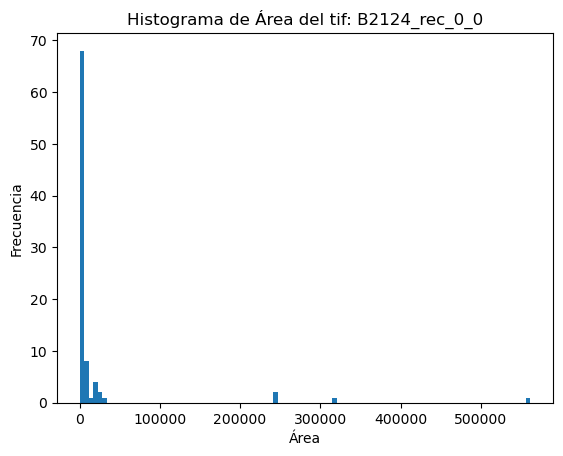

In [33]:
# Dibujar todos los histrogrmas de los tif y guardar

ruta_completa = os.path.join(datapath, 'histo_meta/')
# Crear la carpeta en el directorio especificado
os.makedirs(ruta_completa, exist_ok=True)

for n in range(len(names_list)):
    plt.hist(gdf_list[n]['Area'], bins=100)

    # Agrega etiquetas y título al histograma
    plt.xlabel('Área')
    plt.ylabel('Frecuencia')
    plt.title('Histograma de Área del tif: ' +names_list[n])

    
    # guardo el plot
    plt.savefig(ruta_completa+"plot_"+ names_list[n]+ ".png")

    # Muestra el histograma
    plt.show()